<p style="text-align:center"><img src="https://github.com/WindIO-Bachelorthesis/Shortterm_Forecast/blob/main/images/header.PNG?raw=true"></p>

<p style="text-align:center"><img src="https://camo.githubusercontent.com/4a300a0747dc7b5c69a83cc94ff2e2b5ad1f0f937ed3d142b171c0d4a6f8e164/68747470733a2f2f7777772e67652e636f6d2f72656e657761626c65656e657267792f73697465732f64656661756c742f66696c65732f323032302d30312f6f6e73686f72652d6865726f352e6a7067"/></p>


<h1 align="center">Fourier Transformation</h1>

In [1]:
import pandas as pd
import numpy as np
import plotly
import plotly.express as px
import plotly.graph_objects as go
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error
from math import sqrt
from scipy import integrate
from scipy.signal import butter, lfilter, sosfiltfilt, filtfilt
import warnings
from os import path
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D as mlines
import scipy.signal
warnings.filterwarnings("ignore")

#### Custom plotly template.

In [2]:
custom_template = {
    "layout": go.Layout(
        font={
            "family": "Arial",
            "size": 14,
            "color": "#707070",
        },
        title={
            "font": {
                "family": "Arial",
                "size": 18,
                "color": "#1f1f1f",
            },
        },
        plot_bgcolor="#ffffff",
        paper_bgcolor="#ffffff",
        colorway=px.colors.qualitative.G10,
    )
}

def format_title(title, subtitle=None, subtitle_font_size=14):
    title = f'<b>{title}</b>'
    if not subtitle:
        return title
    subtitle = f'<span style="font-size: {subtitle_font_size}px;">{subtitle}</span>'
    return f'{title}<br>{subtitle}'

#### Please fill in the path to the preprocessed data.

In [3]:
pre_path = "../data/preprocessed/measurement_windio_msb-0002-a_2021-10-21.csv"

#### The following cell shows your preprocessed input data.

In [4]:
df = pd.read_csv(pre_path, parse_dates=["date_time"], index_col="date_time")
df.head()

,uptime,acc_x,acc_y,acc_z,rot_x,rot_y,rot_z,mag_x,mag_y,mag_z,temp
date_time,,,,,,,,,,,
2021-10-21 09:42:23.724786432,54005.42,-0.028870,-0.024475,0.978333,0.931298,0.702290,-0.854962,-292.0,39.0,-271.0,2896.0
2021-10-21 09:42:23.744237312,54005.44,-0.030334,-0.023865,0.981567,0.992366,0.732824,-0.702290,-303.0,40.0,-272.0,2880.0
2021-10-21 09:42:23.763693056,54005.46,-0.029724,-0.020996,0.981995,0.961832,0.824427,-0.839695,-289.0,42.0,-276.0,2848.0
2021-10-21 09:42:23.783293696,54005.48,-0.027405,-0.025330,0.975708,0.809160,0.748092,-0.809160,-307.0,29.0,-281.0,2880.0
2021-10-21 09:42:23.802685440,54005.50,-0.027527,-0.021606,0.979919,0.977099,0.610687,-0.854962,-289.0,39.0,-269.0,2944.0


#### Removes the columns that are not needed and all empty rows.

In [5]:
df.drop(['uptime','acc_z', 'rot_x', 'rot_y', 'rot_z', 'mag_x', 'mag_y', 'mag_z', 'temp'], axis=1, inplace=True)
df.dropna(inplace = True)
df.head()

,acc_x,acc_y
date_time,,
2021-10-21 09:42:23.724786432,-0.028870,-0.024475
2021-10-21 09:42:23.744237312,-0.030334,-0.023865
2021-10-21 09:42:23.763693056,-0.029724,-0.020996
2021-10-21 09:42:23.783293696,-0.027405,-0.025330
2021-10-21 09:42:23.802685440,-0.027527,-0.021606


#### Convert acceleration unit and calculate the velocity / position data.

In [6]:
# Convert acceleration unit from g to m/s^2
df["acc_x"] = df["acc_x"]*9.81
df["acc_y"] = df["acc_y"]*9.81

# Dataframe with same freq. as timeseries
t = df.index.astype('int64')/1e9

# Deinition of the used highpass-filter
def butter_highpass_sosfiltfilt(data, lowcut=0.1, fs=50, pad='even', padlen=500, order=9):
    """
    applies a symmetric filter (no phase offset)
    """
    if pad not in ('even', 'odd', 'constant', None):
        raise Exception('please provide a valid padding')
    # check if len(data > padlen)
    if len(data) < padlen:
        print(
            f'padlen exceeds the number of available data points. Setting padlen to {len(data)}')
        padlen = len(data) - 1
    nyq = fs*0.5
    low = lowcut/nyq
    sos = butter(order, low, btype='highpass', output='sos')
    y = sosfiltfilt(sos, data, padtype=pad, padlen=padlen)
    return y

# Apply highpass-filter for acceleration-data
for c in ['acc_x', 'acc_y']:
    df[c] = butter_highpass_sosfiltfilt(df[c])

# Calculate the velocity-data
for component in ['x', 'y']:
    df.insert(loc=len(df.columns),
        value=integrate.cumtrapz(
            df[f'acc_{component}'], t, initial=0),
        column=f'vel_{component}',)

# Apply highpass-filter for velocity-data
for c in ['vel_x', 'vel_y']:
    df[c] = butter_highpass_sosfiltfilt(df[c])

# Calculate the position-data
for component in ['x', 'y']:
        df.insert(loc=len(df.columns),
            value=integrate.cumtrapz(
                df[f'vel_{component}'], t, initial=0),
            column=f'pos_{component}',)

# Apply highpass-filter for position-data
for c in ['pos_x', 'pos_y']:
    df[c] = butter_highpass_sosfiltfilt(df[c])

# Rename columns
df.rename(columns={'acc_x': 'acc_x ($m/s^{2}$)','acc_y': 'acc_y ($m/s^{2}$)', 
                   'vel_x': 'vel_x ($m/s$)', 'vel_y': 'vel_y ($m/s$)', 
                   'pos_x': 'pos_x ($m$)', 'pos_y': 'pos_y ($m$)'
                  }, inplace=True, errors='raise')
df.head()

,acc_x ($m/s^{2}$),acc_y ($m/s^{2}$),vel_x ($m/s$),vel_y ($m/s$),pos_x ($m$),pos_y ($m$)
date_time,,,,,,
2021-10-21 09:42:23.724786432,0.042270,-0.030006,-0.033023,-0.010705,0.082647,0.004730
2021-10-21 09:42:23.744237312,0.027894,-0.024017,-0.032277,-0.011219,0.081668,0.004484
2021-10-21 09:42:23.763693056,0.033878,0.004126,-0.031607,-0.011400,0.080689,0.004231
2021-10-21 09:42:23.783293696,0.056627,-0.038384,-0.030645,-0.011723,0.079708,0.003970
2021-10-21 09:42:23.802685440,0.055428,-0.001858,-0.029479,-0.012099,0.078740,0.003704


#### Plots an intervall of the x and y postion data.

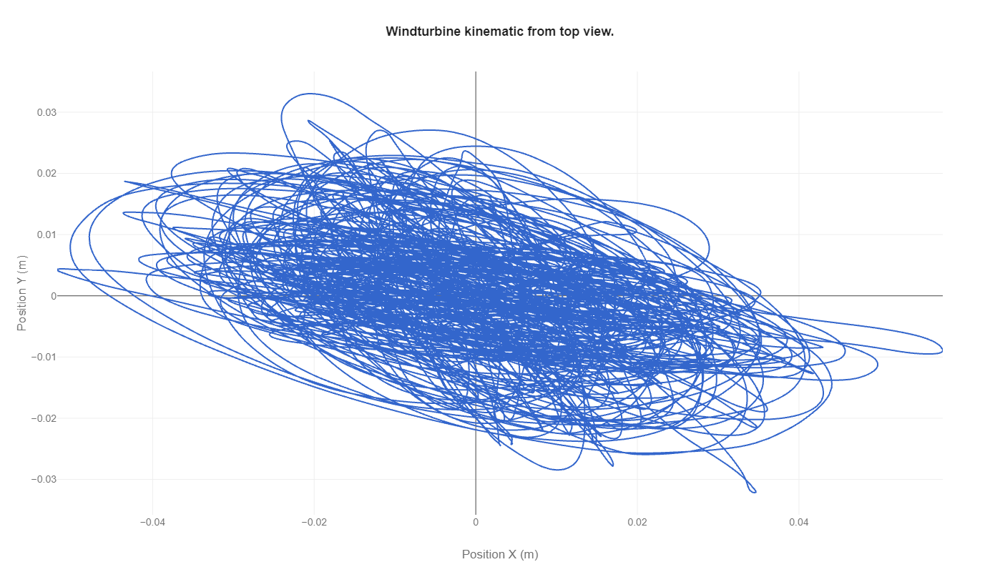

In [7]:
# Select subset of the origin time-series
df2 = df.iloc[5000:30000,:]
fig = px.line(df2, x='pos_x ($m$)', y='pos_y ($m$)', title=format_title("Windturbine kinematic from top view."), 
              labels={
                     'pos_x ($m$)': "Position X (m)",
                     'pos_y ($m$)': "Position Y (m)"
                 },width=800, height=800, template=custom_template) 
fig.show()

#### Plots the x and y position over time.

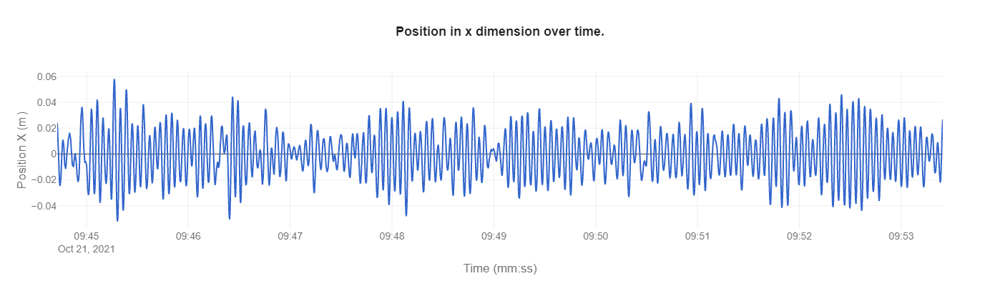

In [8]:
fig = px.line(df2, y='pos_x ($m$)', title=format_title("Position in x dimension over time."), 
              labels={
                     'date_time': "Time (mm:ss)",
                     'pos_x ($m$)': "Position X (m)"
                 }, width=1200, height=400, template=custom_template) 
fig.show()

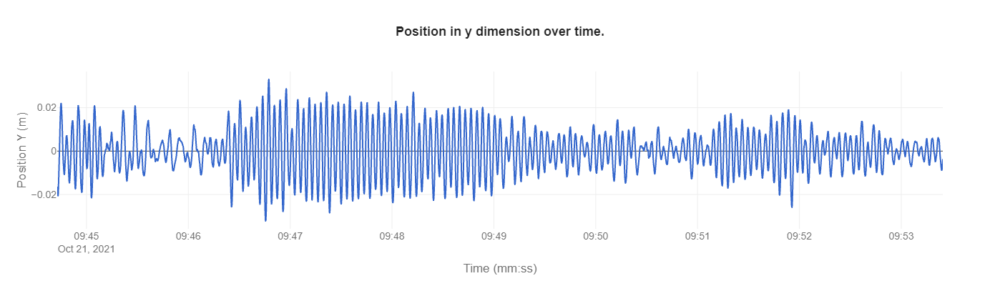

In [19]:
fig = px.line(df2, y='pos_y ($m$)', title=format_title("Position in y dimension over time."), 
              labels={
                     'date_time': "Time (mm:ss)",
                     'pos_y ($m$)': "Position Y (m)"
                 }, width=800, height=400, template=custom_template) 
fig.show()

### Fast Fourier Transformation

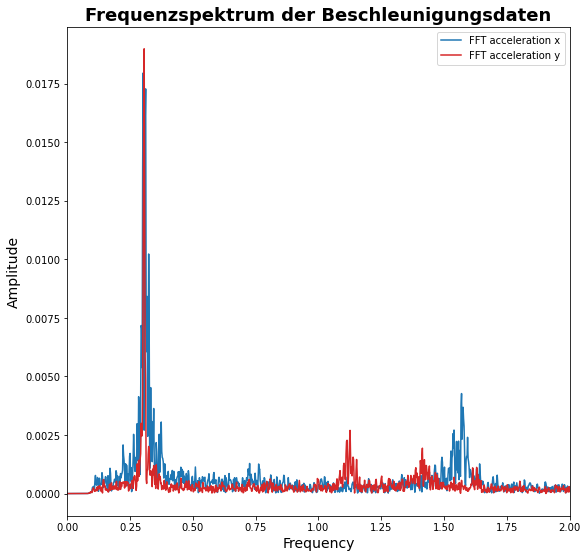

In [10]:
fig = plt.figure(figsize=(9, 9))
plt.title('Frequenzspektrum der Beschleunigungsdaten' , size=18,fontweight="bold")
ax1 = plt.gca()
ax1.magnitude_spectrum(df2['acc_x ($m/s^{2}$)'], Fs=50, color='tab:blue')
ax1.magnitude_spectrum(df2['acc_y ($m/s^{2}$)'], Fs=50, color='tab:red')
                
ax1.set_xlim([0, 2])
ax1.set_xlabel('Frequency', size=14)
ax1.set_ylabel('Amplitude', size=14)

        
ax1.legend(handles = [mlines([0], [0], color='tab:blue', label='FFT acceleration x'), mlines([0], [0], color='tab:red' , label='FFT acceleration y')])
plt.savefig("figure1.png")

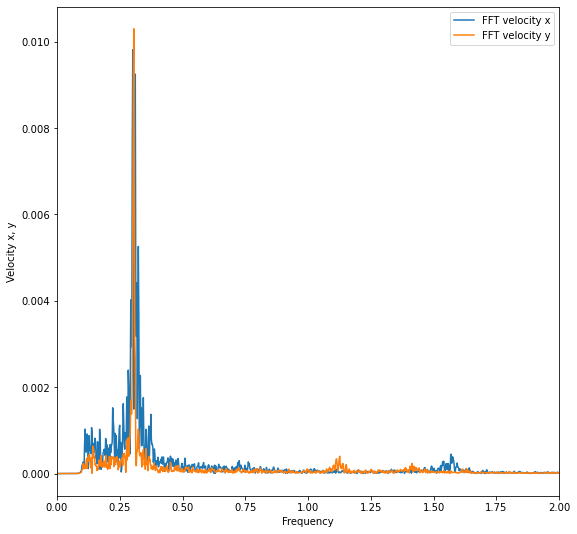

In [11]:
fig = plt.figure(figsize=(9, 9))
ax1 = plt.gca()
ax1.magnitude_spectrum(df2['vel_x ($m/s$)'], Fs=50, color='tab:blue')
ax1.magnitude_spectrum(df2['vel_y ($m/s$)'], Fs=50, color='tab:orange')
                
ax1.set_xlim([0, 2])
ax1.set_ylabel('Velocity x, y')
        
ax1.legend(handles = [mlines([0], [0], color='tab:blue', label='FFT velocity x'), mlines([0], [0], color='tab:orange' , label='FFT velocity y')])

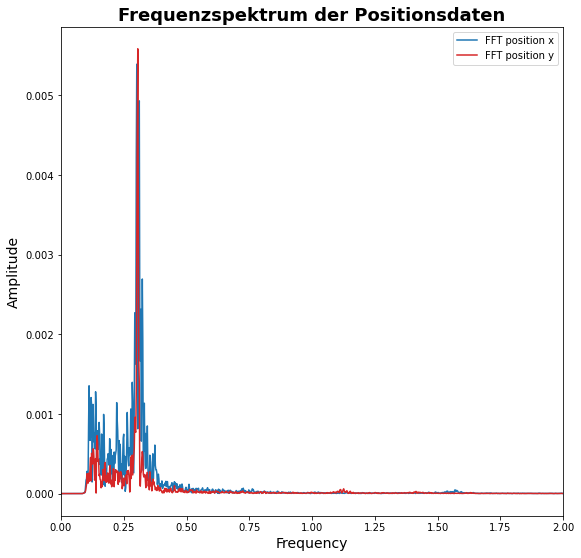

In [12]:
fig = plt.figure(figsize=(9, 9))
plt.title('Frequenzspektrum der Positionsdaten' , size=18,fontweight="bold")
ax1 = plt.gca()
ax1.magnitude_spectrum(df2['pos_x ($m$)'], Fs=50, color='tab:blue')
ax1.magnitude_spectrum(df2['pos_y ($m$)'], Fs=50, color='tab:red')
                
ax1.set_xlim([0, 2])
ax1.set_xlabel('Frequency', size=14)
ax1.set_ylabel('Amplitude', size=14)

        
ax1.legend(handles = [mlines([0], [0], color='tab:blue', label='FFT position x'), mlines([0], [0], color='tab:red' , label='FFT position y')])
plt.savefig("figure1.png")


In [13]:
import numpy as np
from scipy.signal import butter,filtfilt
# Filter requirements.
fs = 50.0       # sample rate, Hz
cutoff = 0.3    # desired cutoff frequency of the filter, Hz ,      slightly higher than actual 1.2 Hz
nyq = 0.5 * fs  # Nyquist Frequency
order = 2       # sin wave can be approx represented as quadratic
n = 25000 # total number of samples


def butter_lowpass_filter(data, cutoff, fs, order):
    normal_cutoff = cutoff / nyq
    # Get the filter coefficients 
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    y = filtfilt(b, a, data)
    return y


df2.reset_index(inplace=True)
# Filter the data, and plot both the original and filtered signals.
df2['pos_a ($m$)'] = pd.Series(butter_lowpass_filter(df2['pos_x ($m$)'], cutoff, fs, order))
df2['pos_b ($m$)'] = pd.Series(butter_lowpass_filter(df2['pos_y ($m$)'], cutoff, fs, order))
df2.set_index("date_time", inplace=True)

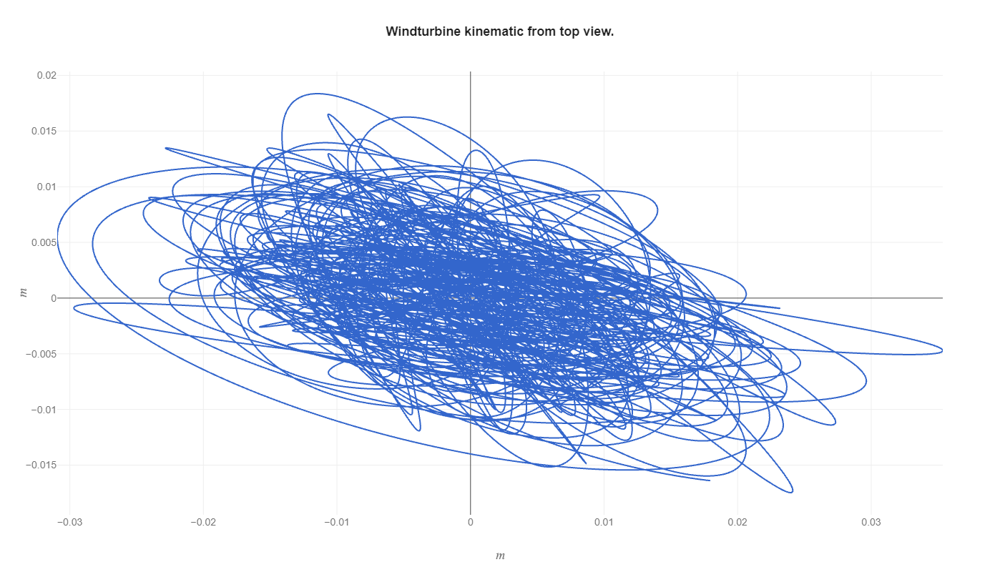

In [14]:
# Select subset of the origin time-series
fig = px.line(df2, x='pos_a ($m$)', y='pos_b ($m$)', title=format_title("Windturbine kinematic from top view."), 
              labels={
                     'pos_x ($m$)': "Position X (m)",
                     'pos_y ($m$)': "Position Y (m)"
                 },width=800, height=800, template=custom_template) 
fig.show()

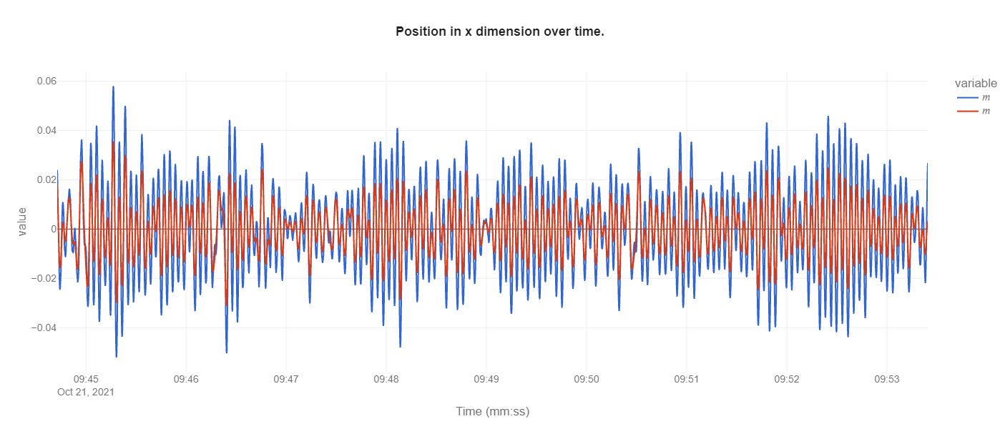

In [21]:
fig = px.line(df2, y=['pos_x ($m$)','pos_a ($m$)'], title=format_title("Position in x dimension over time."), 
              labels={
                     'date_time': "Time (mm:ss)",
                     'pos_x ($m$)': "Position X (m)"
                 }, width=1200, height=600, template=custom_template) 
fig.show()

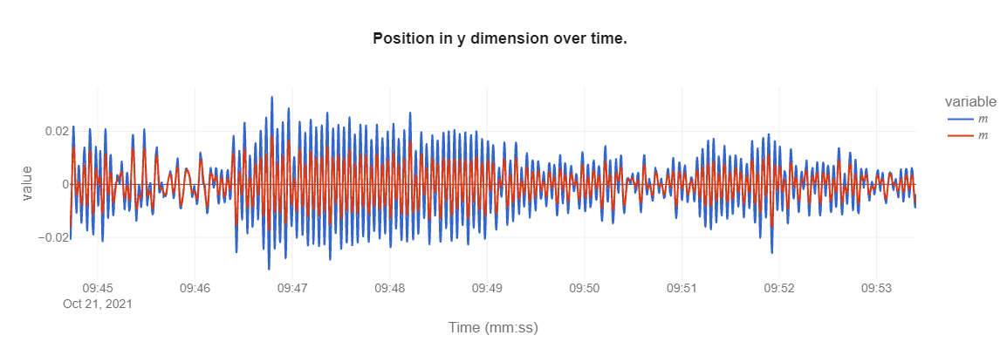

In [16]:
fig = px.line(df2, y=['pos_y ($m$)','pos_b ($m$)'], title=format_title("Position in y dimension over time."), 
              labels={
                     'date_time': "Time (mm:ss)",
                     'pos_y ($m$)': "Position Y (m)"
                 }, width=1200, height=400, template=custom_template) 
fig.show()

In [17]:
df2.describe()

,acc_x ($m/s^{2}$),acc_y ($m/s^{2}$),vel_x ($m/s$),vel_y ($m/s$),pos_x ($m$),pos_y ($m$),pos_a ($m$),pos_b ($m$)
count,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000
mean,0.000061,0.000036,0.000007,0.000025,-0.000034,-0.000014,-0.000042,-0.000010
std,0.074716,0.051836,0.031985,0.018331,0.017975,0.010261,0.009953,0.005596
min,-0.822011,-0.831557,-0.094462,-0.055078,-0.051808,-0.032155,-0.030943,-0.017472
25%,-0.050614,-0.030691,-0.024167,-0.011919,-0.013491,-0.006667,-0.007249,-0.003770
50%,-0.000086,0.000057,-0.000380,0.000200,-0.000090,0.000034,0.000012,0.000079
75%,0.050528,0.030936,0.024273,0.011826,0.013410,0.006363,0.007059,0.003549
max,0.981457,0.799343,0.093489,0.059037,0.057802,0.033026,0.035357,0.018358
